<a href="https://colab.research.google.com/github/SaharRamezani/30DaysOfWellness/blob/master/ChangeDetector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
"""
Change Detection on Video with SLIC Superpixels

Setup Virtual Environment:

  # Create and activate a new venv
  python3 -m venv venv
  source venv/bin/activate

  # Install dependencies
  pip install -r requirements.txt

Create a requirements.txt containing:
  numpy
  matplotlib
  scikit-image
  imageio

Usage:
  python detect_changes.py path/to/video.mp4
"""
import sys
import numpy as np
import matplotlib.pyplot as plt
import imageio
from skimage import segmentation, color
from skimage.measure import regionprops

In [24]:
def segment_image(image, n_segments=100, compactness=50):
    segments = segmentation.slic(image, n_segments=n_segments,
                                 compactness=compactness, start_label=1)
    return segments


def extract_superpixel_features(image, segments):
    lab = color.rgb2lab(image)
    gray = color.rgb2gray(image)
    props = regionprops(segments) # compute properties (label, coords, centroid, etc.) for each superpixel region
    features, centroids = {}, {}
    for prop in props:
        label = prop.label
        coords = prop.coords
        mean_lab = np.mean(lab[coords[:,0], coords[:,1]], axis=0)
        mean_int = np.mean(gray[coords[:,0], coords[:,1]])
        features[label] = np.hstack((mean_lab, mean_int)) # Combine them into one 4-dimensional feature vector
        centroids[label] = prop.centroid
    return features, centroids


def match_superpixels(feat_t, cent_t, feat_t1, cent_t1,
                      max_spatial_dist=5, feat_dist_thresh=10):
    labels_t, labels_t1 = list(feat_t), list(feat_t1)
    changed, matches = set(), {}

    cent_arr_t = np.array([cent_t[l] for l in labels_t])
    cent_arr_t1 = np.array([cent_t1[l] for l in labels_t1])
    feat_arr_t = np.array([feat_t[l] for l in labels_t])
    feat_arr_t1 = np.array([feat_t1[l] for l in labels_t1])

    for i, lbl in enumerate(labels_t):
        dists = np.linalg.norm(cent_arr_t1 - cent_arr_t[i], axis=1)
        candidates = np.where(dists < max_spatial_dist)[0]
        if not len(candidates):
            changed.add(lbl)
            continue
        fdists = np.linalg.norm(feat_arr_t1[candidates] - feat_arr_t[i], axis=1)
        best_idx = candidates[np.argmin(fdists)]
        matches[lbl] = labels_t1[best_idx]
        if np.min(fdists) > feat_dist_thresh:
            changed.add(lbl)

    return matches, changed


def detect_changes(frame_t, frame_t1):
    seg_t = segment_image(frame_t)
    seg_t1 = segment_image(frame_t1)
    feat_t, cent_t = extract_superpixel_features(frame_t, seg_t)
    feat_t1, cent_t1 = extract_superpixel_features(frame_t1, seg_t1)
    matches, changed = match_superpixels(feat_t, cent_t, feat_t1, cent_t1)
    mask = np.zeros(frame_t.shape[:2], dtype=bool)
    for lbl in changed:
        mask[seg_t == lbl] = True
    return seg_t, seg_t1, mask


def visualize(frame_t, frame_t1, mask):
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))
    axes[0].imshow(frame_t)
    axes[0].contour(mask, colors='r', linewidths=1.5)
    axes[0].set_title('Changes on t')
    axes[1].imshow(frame_t1)
    axes[1].contour(mask, colors='r', linewidths=1.5)
    axes[1].set_title('Changes on t+1')
    for ax in axes:
        ax.axis('off')
    plt.tight_layout()
    plt.show()

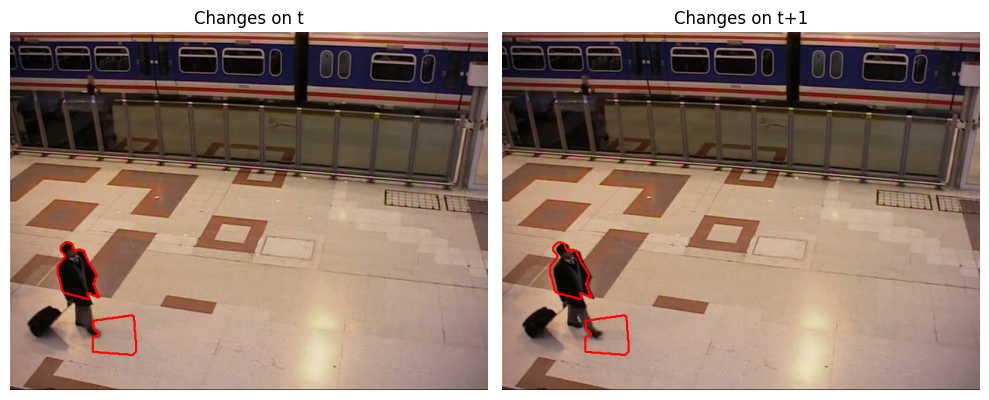

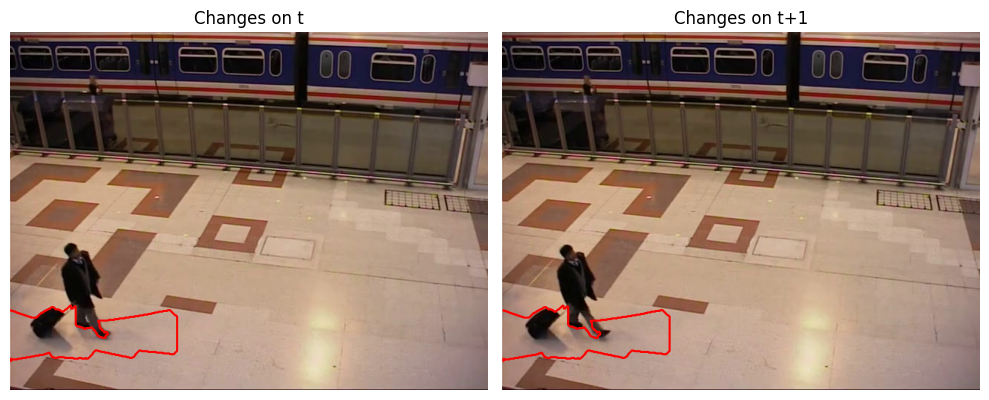

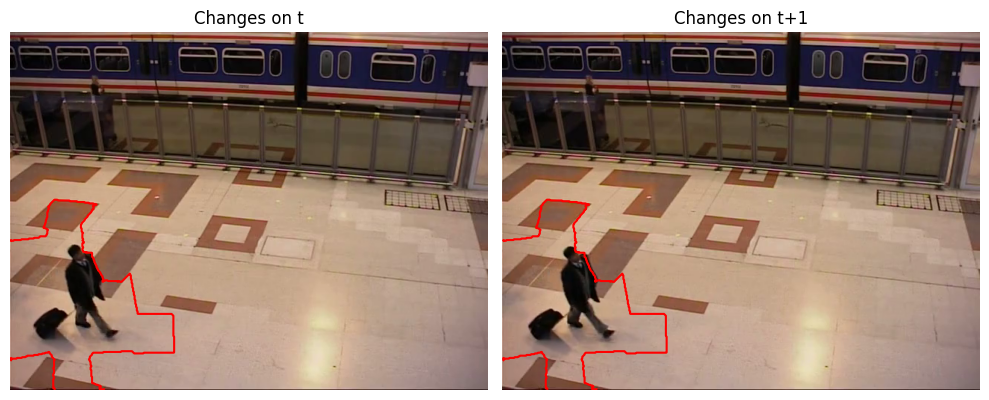

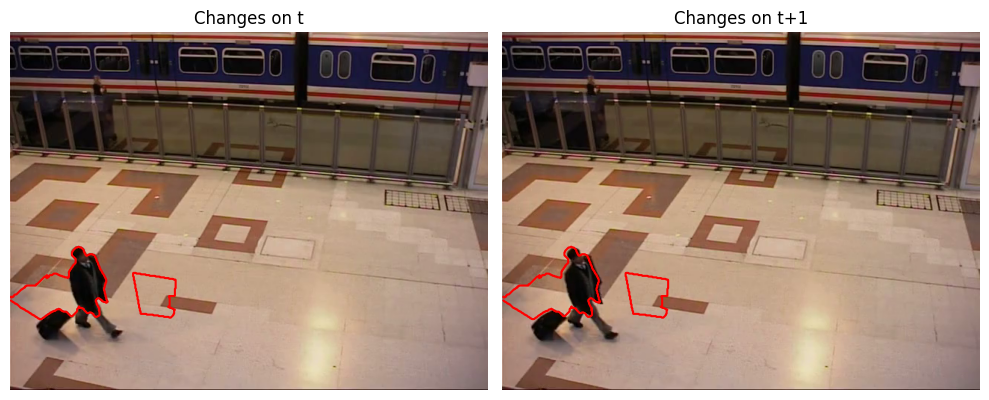

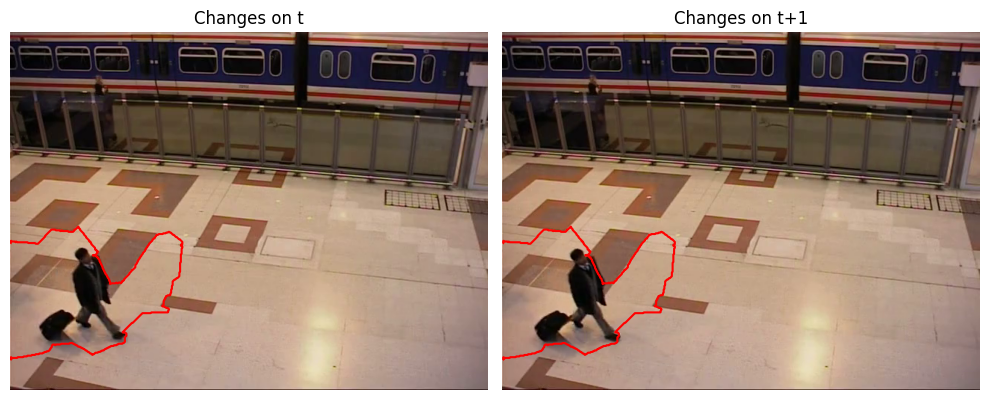

...

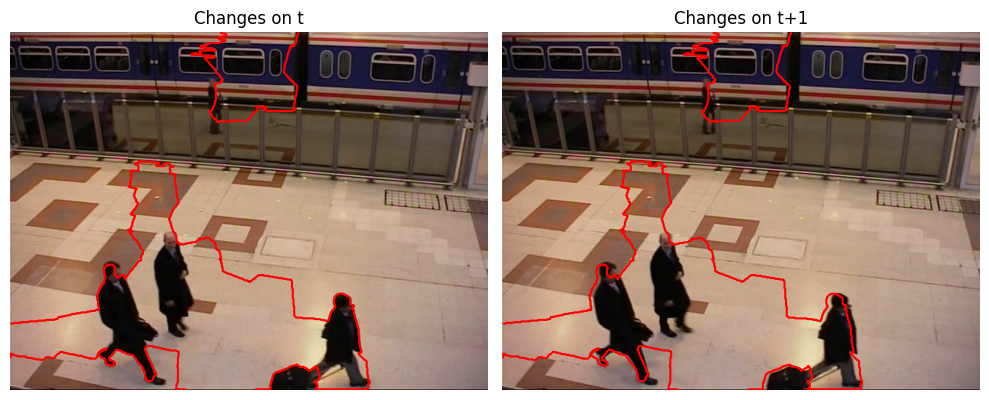

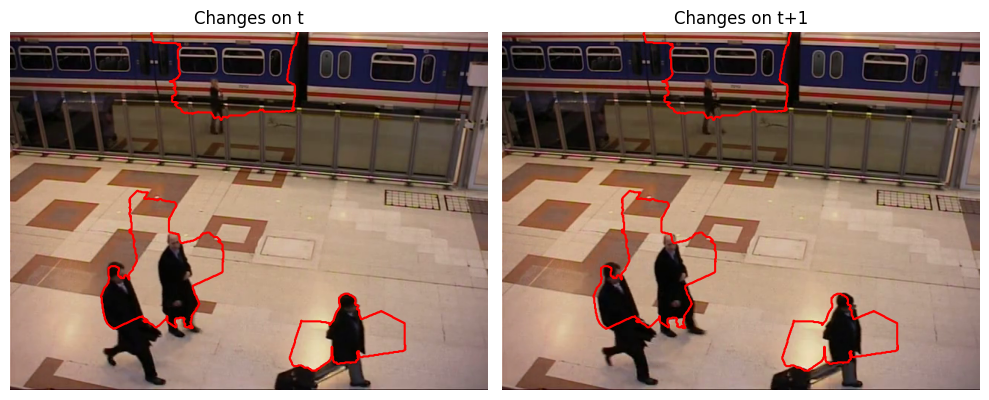

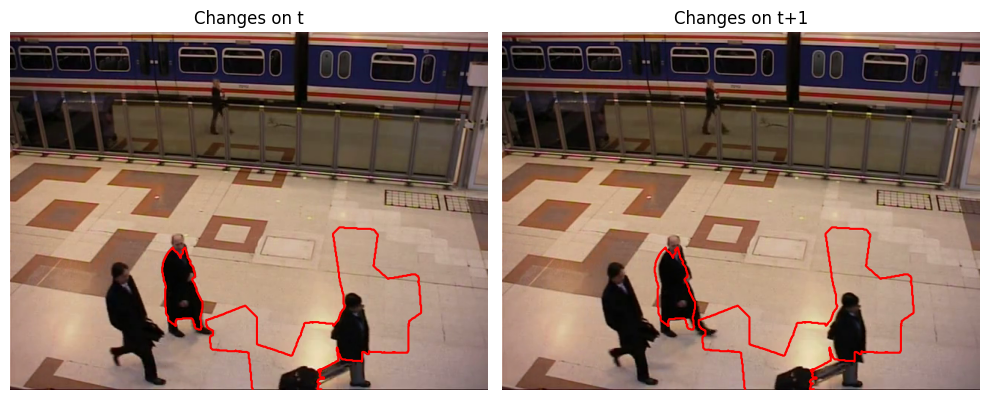

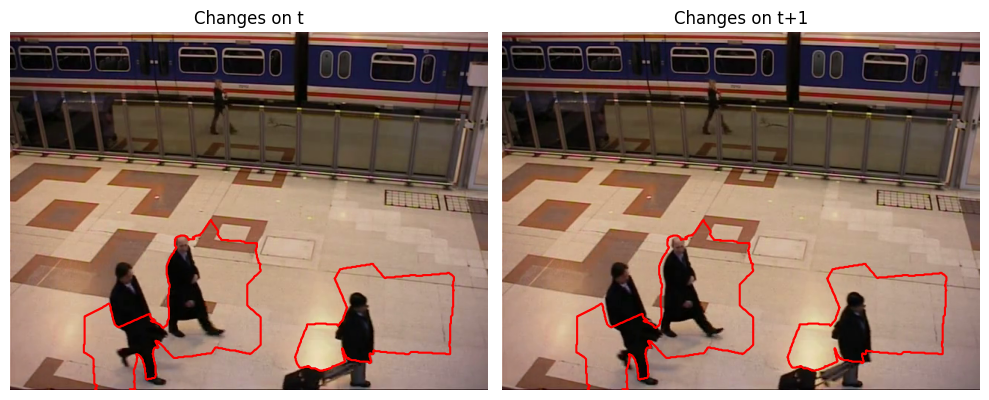

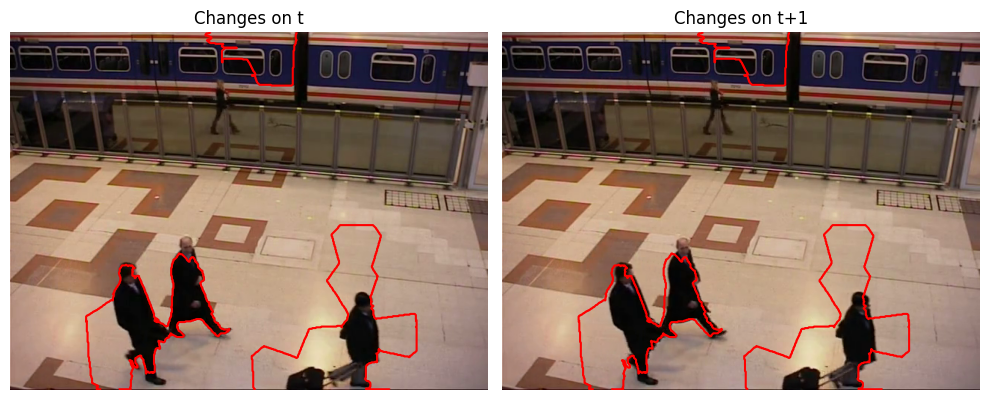

In [25]:
if __name__ == '__main__':
  if len(sys.argv) < 2:
      sys.exit(1)
  video_path = "/content/input.mp4"
  reader = imageio.get_reader(video_path)

  prev_frame = None
  for frame in reader:
      # imageio returns uint8 in RGB order
      if prev_frame is None:
          prev_frame = frame
          continue
      # detect and visualize changes between prev and current
      seg_t, seg_t1, change_mask = detect_changes(prev_frame, frame)
      visualize(prev_frame, frame, change_mask)
      prev_frame = frame